#Attempt to implement Dave's wavelet algorith

Concerns:

* Can wavelets handle gaps in data?
 * Looks like no (judging by input)
* Can wavelets handle uneven cadence?
 * Looks like no (judging by input)
* How computationally heavy is wavelets? Do I need to bin?



# First look

In [1]:
%load_ext autoreload
%autoreload 1

%aimport functions.load_lc
lc = functions.load_lc

%aimport functions.waveletrun
wr = functions.waveletrun

%aimport functions.combine_data
cd = functions.combine_data

%aimport functions.autocorrelation
ac = functions.autocorrelation

%aimport functions.util
ut = functions.util

%aimport functions.plot_wavelets
pw = functions.plot_wavelets

%matplotlib inline

from functions import *

import matplotlib.pyplot as plt
import pickle
import wavelets
import numpy as np

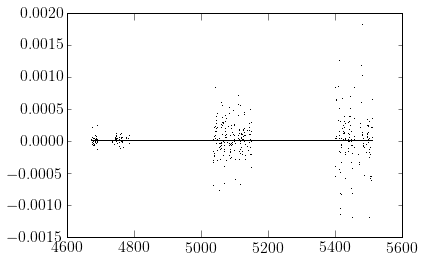

In [2]:

wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

HJD_s2, mag_s2, err_s2 = sum_duplicates(HJD_s2,mag_s2,err_s2)
t = HJD_s2.copy()

min_cadence = min(np.diff(t))

HJD_s2, mag_s2 = FillGapsZeros(t,mag_s2,min_cadence)
HJD_s2, err_s2 = FillGapsZeros(t,err_s2,min_cadence)

binning = 1000

HJD_s2, mag_s2 = BinLC(HJD_s2, mag_s2,binning)

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [3]:
print min(np.diff(HJD_s2)), max(np.diff(HJD_s2))

0.185104476728 0.185256918084


ehh... close enough for a first look

In [4]:
wa = wavelets.WaveletAnalysis(mag_s2,wavelet=wavfunc(),dt=min(np.diff(HJD_s2)),dj=0.01,unbias=True)

In [5]:
wa.mask_coi = True

#calculate global power spectrum for fitting
globspec = wa.global_wavelet_spectrum

gws_fitparams = FitGWS(globspec,wa.scales)


Wavelet GPS Peak Scale: 16.5586193382
Wavelet GPS Peak Period: 17.1057765229


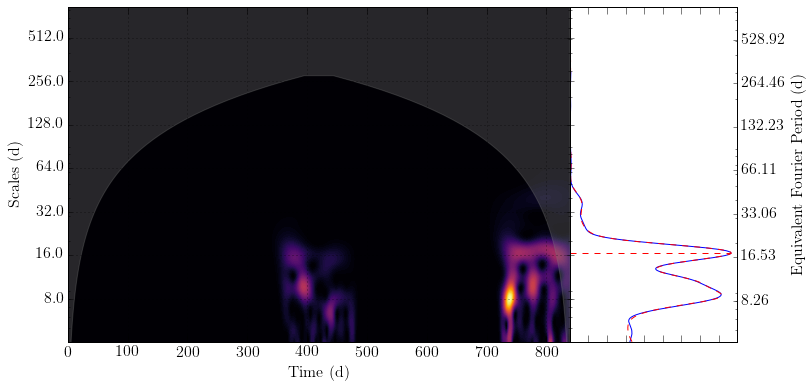

In [6]:
minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test.pdf')
plt.show()

# same test, different scale

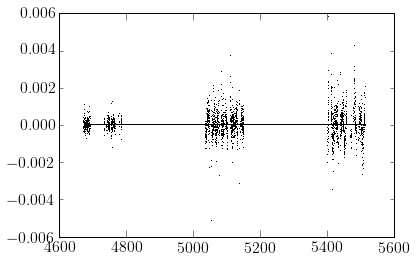

In [7]:
from functions import *
import matplotlib.pyplot as plt
%matplotlib inline

wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

HJD_s2, mag_s2, err_s2 = sum_duplicates(HJD_s2,mag_s2,err_s2)
t = HJD_s2.copy()

min_cadence = min(np.diff(t))

HJD_s2, mag_s2 = FillGapsZeros(t,mag_s2,min_cadence)
HJD_s2, err_s2 = FillGapsZeros(t,err_s2,min_cadence)

binning = 100

HJD_s2, mag_s2 = BinLC(HJD_s2, mag_s2,binning)

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [8]:
wa = wavelets.WaveletAnalysis(mag_s2,wavelet=wavfunc(),dt=min(np.diff(HJD_s2)),dj=0.01,unbias=True)

In [9]:
wa.mask_coi = True

#calculate global power spectrum for fitting
globspec = wa.global_wavelet_spectrum

gws_fitparams = FitGWS(globspec,wa.scales)


/home/astro/phrmat/anaconda/lib/python2.7/site-packages/scipy/optimize/minpack.py:421: RuntimeWarning: Number of calls to function has reached maxfev = 10000.
  warnings.warn(errors[info][0], RuntimeWarning)


Wavelet GPS Peak Scale: 16.4826276996
Wavelet GPS Peak Period: 17.0272738433


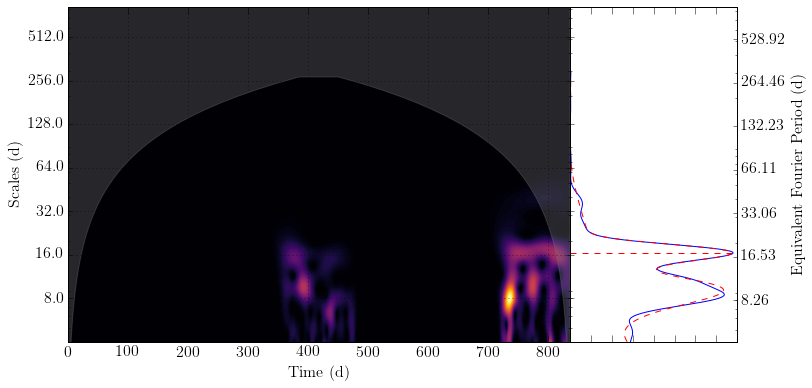

In [10]:
minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test2.pdf')
plt.show()

# Same test, no binning

Ok... that caused a memory error on sirius. let's not. binning of 10?

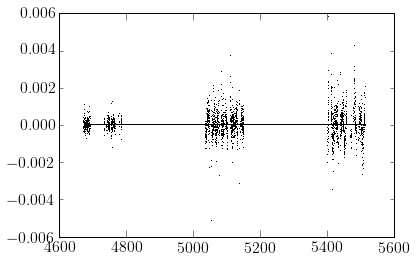

In [11]:
from functions import *
import matplotlib.pyplot as plt
%matplotlib inline

wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

HJD_s2, mag_s2, err_s2 = sum_duplicates(HJD_s2,mag_s2,err_s2)
t = HJD_s2.copy()

min_cadence = min(np.diff(t))

HJD_s2, mag_s2 = FillGapsZeros(t,mag_s2,min_cadence)
HJD_s2, err_s2 = FillGapsZeros(t,err_s2,min_cadence)

binning = 100
HJD_s2, mag_s2 = BinLC(HJD_s2, mag_s2,binning)

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [12]:
wa = wavelets.WaveletAnalysis(mag_s2,wavelet=wavfunc(),dt=min(np.diff(HJD_s2)),dj=0.01,unbias=True)

In [13]:
wa.mask_coi = True

#calculate global power spectrum for fitting
globspec = wa.global_wavelet_spectrum

gws_fitparams = FitGWS(globspec,wa.scales)


Wavelet GPS Peak Scale: 16.4826276996
Wavelet GPS Peak Period: 17.0272738433


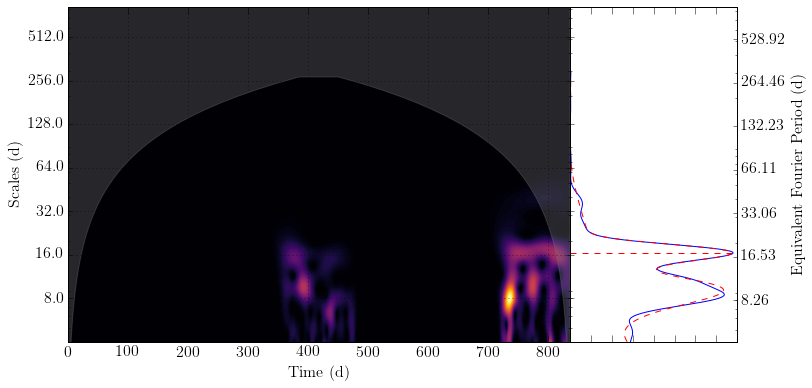

In [14]:
minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test_unbinned.pdf')
plt.show()

#With nightly binning / even bin sizes

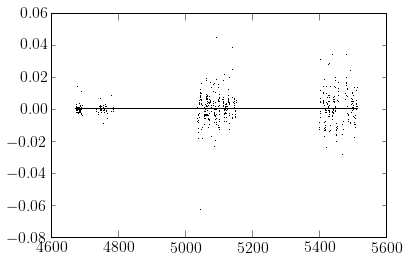

In [15]:
from functions import *
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

first_day = int(min(HJD_s2)) + 0.0
last_day = int(max(HJD_s2)) + 1.0
dt = 0.1

HJD_s2, mag_s2, err_s2 = time_binning(mag_s2,err_s2,HJD_s2,dt,[first_day,last_day])

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [16]:
wa = wavelets.WaveletAnalysis(mag_s2,wavelet=wavfunc(),dt=min(np.diff(HJD_s2)),dj=0.01,unbias=True)

In [17]:
wa.mask_coi = True

#calculate global power spectrum for fitting
globspec = wa.global_wavelet_spectrum

gws_fitparams = FitGWS(globspec,wa.scales)


pickle.dump([wa,globspec,gws_fitparams],open('wavelet_bin/01_binning.p','w'))

Wavelet GPS Peak Scale: 16.4631750627
Wavelet GPS Peak Period: 17.0071784203


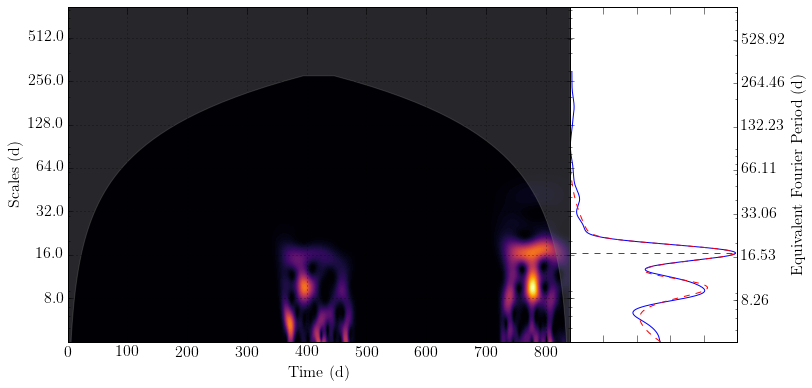

In [18]:
from functions import *
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

data = pickle.load(open('wavelet_bin/01_binning.p','r'))

wa = data[0]
globspec = data[1]
gws_fitparams = data[2]

minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test_01days_grey.pdf')
plt.show()

# New formatting...

In [1]:
%load_ext autoreload
%autoreload 1

%aimport functions.load_lc
lc = functions.load_lc

%aimport functions.waveletrun
wr = functions.waveletrun

%aimport functions.combine_data
cd = functions.combine_data

%aimport functions.autocorrelation
ac = functions.autocorrelation

%aimport functions.util
ut = functions.util

%aimport functions.plot_wavelets
pw = functions.plot_wavelets

%matplotlib inline
import matplotlib.pyplot as plt
import pickle
import wavelets
import numpy as np

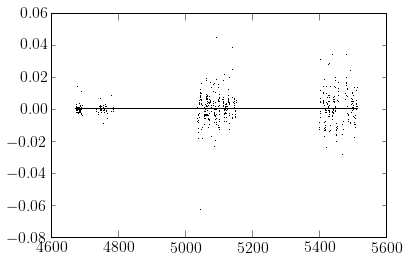

In [2]:
wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

first_day = int(min(HJD_s2)) + 0.0
last_day = int(max(HJD_s2)) + 1.0
dt = 0.1

HJD_s2, mag_s2, err_s2 = ut.time_binning(mag_s2,err_s2,HJD_s2,dt,[first_day,last_day])

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [3]:
data = pickle.load(open('wavelet_bin/01_binning.p','r'))

Wavelet GPS Peak Scale: 16.1243678192
Wavelet GPS Peak Period: 16.6571757496


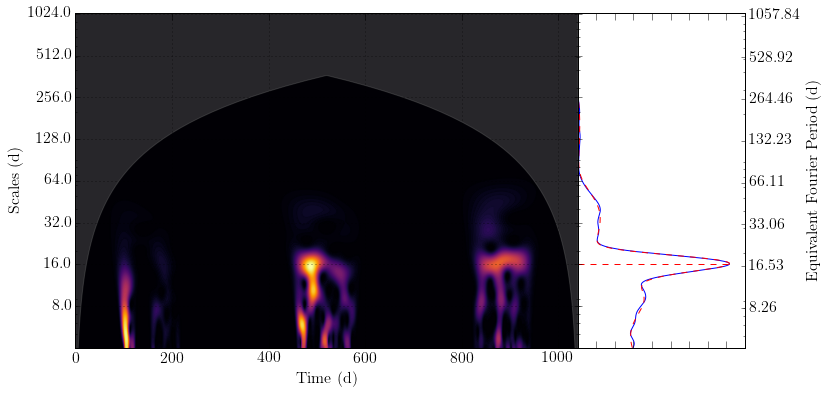

In [4]:
wa = data[0]
globspec = data[1]
gws_fitparams = data[2]

minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test_01days.pdf')
plt.show()

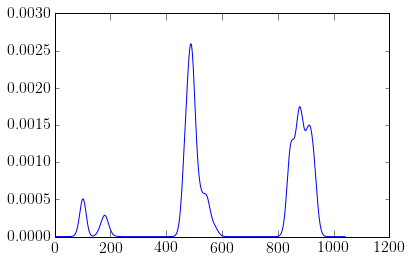

In [5]:
pw.plot_wavelet_slice(wa,globspec, minscale,gws_fitparams,14,21, savename = 'figures/test_01days_slice.pdf')

# Fold lightcurves on best period

Taking the best period from the previous segment, let's fold on that period.

In [6]:
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMTFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)

HJD_tamtfa = wasp_dict['HJD']
mag_tamtfa = wasp_dict['mag']
err_tamtfa = wasp_dict['err']

mag_tamtfa -= np.median(mag_tamtfa)


In [7]:
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TFA.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)

HJD_tfa = wasp_dict['HJD']
mag_tfa = wasp_dict['mag']
err_tfa = wasp_dict['err']

mag_tfa -= np.median(mag_tfa)


In [8]:
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMUZ.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)

HJD_tamuz = wasp_dict['HJD']
mag_tamuz = wasp_dict['mag']
err_tamuz = wasp_dict['err']

mag_tamuz -= np.median(mag_tamuz)

period = 17.2445897838
period = 16.38
epoch = min(HJD_tamuz)
dp = 0.01

HJD = HJD_tfa.copy()

I just want to compare with the WASP-52 detection paper for now, to make sure that some variability is showing up, so I take their period 0f 16.38 for their 'season 2'

In [9]:
phase, mag_phase_tamuz, err_phase_tamuz = ut.phase_binning(mag_tamuz[(HJD > 5035) & (HJD < 5150)],err_tamuz[(HJD > 5035) & (HJD < 5150)],HJD[(HJD > 5035) & (HJD < 5150)],period,epoch,dp)

phase, mag_phase_tfa, err_phase_tfa = ut.phase_binning(mag_tfa[(HJD > 5035) & (HJD < 5150)],err_tfa[(HJD > 5035) & (HJD < 5150)],HJD[(HJD > 5035) & (HJD < 5150)],period,epoch,dp)

phase, mag_phase_tamtfa, err_phase_tamtfa = ut.phase_binning(mag_tamtfa[(HJD > 5035) & (HJD < 5150)],err_tamtfa[(HJD > 5035) & (HJD < 5150)],HJD[(HJD > 5035) & (HJD < 5150)],period,epoch,dp)

In [10]:
p = ((HJD[(HJD > 5035) & (HJD < 5150)] - epoch)/period)
for i in range(0,len(p)):
    p[i] -= int(p[i])

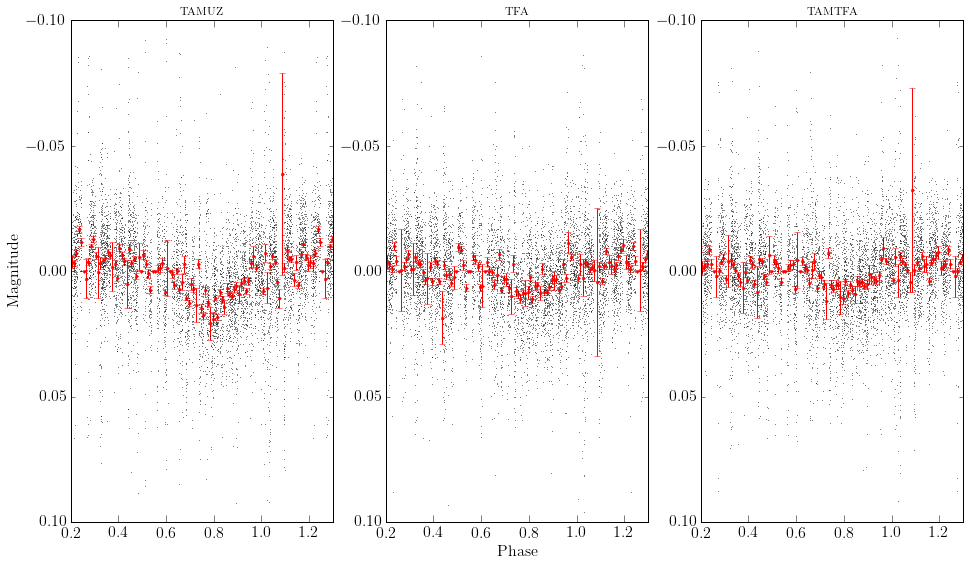

In [11]:
fig, ax = plt.subplots(1,3)

fig.set_size_inches(16, 9)

i = 0

labels = ['TAMUZ','TFA','TAMTFA']
mags = [mag_tamuz, mag_tfa, mag_tamtfa]
phase_mags = [mag_phase_tamuz, mag_phase_tfa, mag_phase_tamtfa]
phase_errs = [err_phase_tamuz, err_phase_tfa, err_phase_tamtfa]

for mag in (mag_tamuz, mag_tfa, mag_tamtfa):
    ax[i].plot(p,mag[(HJD > 5035) & (HJD < 5150)],'k,',alpha=0.5)
    ax[i].plot(p+1,mag[(HJD > 5035) & (HJD < 5150)],'k,',alpha=0.5)
    ax[i].errorbar(phase,phase_mags[i],yerr=phase_errs[i],fmt='r.')
    ax[i].errorbar(phase+1,phase_mags[i],yerr=phase_errs[i],fmt='r.')
    ax[i].set_xlim(0.2,1.3)
    ax[i].set_ylim(0.1,-0.1)
    ax[i].set_title(labels[i])
    ax[0].set_ylabel('Magnitude')
    ax[1].set_xlabel('Phase')
    i += 1
    
plt.show()

TFA algorithm has a tendency to decrease the strength of the signal - TAMTFA is even worse, it can reverse it!
This means I should make the wavelets plot again with TAMUZ detrending only.

# Wavelets using the TAMUZ lightcurves

In [12]:
%load_ext autoreload
%autoreload 1

%aimport functions.load_lc
lc = functions.load_lc

%aimport functions.waveletrun
wr = functions.waveletrun

%aimport functions.combine_data
cd = functions.combine_data

%aimport functions.autocorrelation
ac = functions.autocorrelation

%aimport functions.util
ut = functions.util

%aimport functions.plot_wavelets
pw = functions.plot_wavelets

%matplotlib inline
import matplotlib.pyplot as plt
import pickle
import wavelets
import numpy as np

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


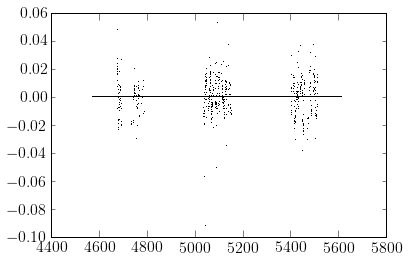

In [13]:
wavfunc = wavelets.Morlet
#wavfunc = wavelets.Ricker
fname = '1SWASPJ231358.76+084540.6_WASP52B_100_ORKP_TAMUZ.lc'
wasp_dict = lc.load_wasp_lc('lightcurves/'+fname)
s2 = (wasp_dict['HJD'] > 5035) & (wasp_dict['HJD'] < 5151)

HJD_s2 = wasp_dict['HJD']
mag_s2 = wasp_dict['mag']
err_s2 = wasp_dict['err']

mag_s2 -= np.median(mag_s2)

first_day = int(min(HJD_s2)) + 0.0 -100
last_day = int(max(HJD_s2)) + 1.0 + 100
dt = 0.1

HJD_s2, mag_s2, err_s2 = ut.time_binning(mag_s2,err_s2,HJD_s2,dt,[first_day,last_day])

plt.plot(HJD_s2,mag_s2,'k,')
plt.show()

In [14]:
dj=0.01
wa = wavelets.WaveletAnalysis(mag_s2,wavelet=wavfunc(),dt=min(np.diff(HJD_s2)),dj=dj,unbias=True)

In [15]:
wa.mask_coi = True

#calculate global power spectrum for fitting
globspec = wa.global_wavelet_spectrum

gws_fitparams = wr.FitGWS(globspec,wa.scales)


pickle.dump([wa,globspec,gws_fitparams],open('wavelet_bin/01_binning.p','w'))

/home/astro/phrmat/anaconda/lib/python2.7/site-packages/scipy/optimize/minpack.py:421: RuntimeWarning: Number of calls to function has reached maxfev = 10000.
  warnings.warn(errors[info][0], RuntimeWarning)


In [16]:
data = pickle.load(open('wavelet_bin/01_binning.p','r'))

Wavelet GPS Peak Scale: 16.1243678192
Wavelet GPS Peak Period: 16.6571757496


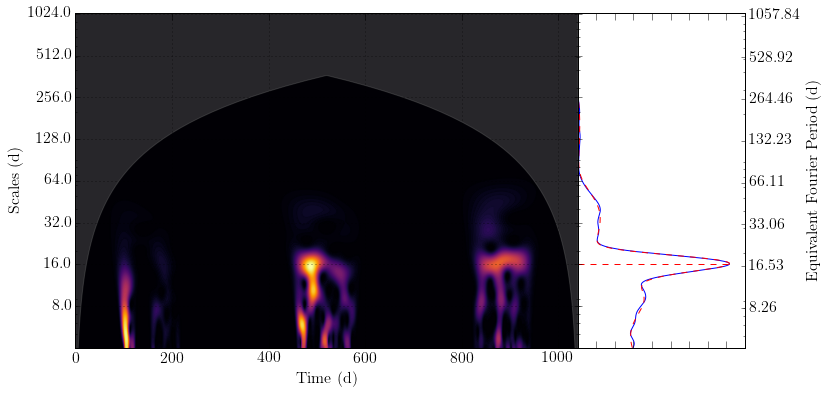

In [17]:
wa = data[0]
globspec = data[1]
gws_fitparams = data[2]

minscale = 4
pw.plot_wavelet(wa,globspec, minscale,gws_fitparams, savename = 'figures/test_01days_custom.pdf')
plt.show()

In [18]:
peak_period = pw.get_peak_period(wa,globspec,minscale)

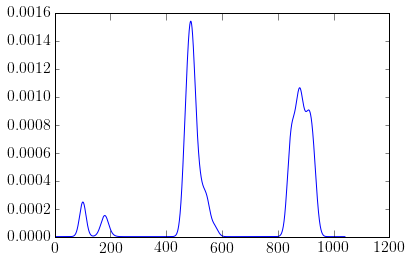

In [19]:
pw.plot_wavelet_slice(wa,globspec, minscale,gws_fitparams,peak_period/1.1,peak_period*1.1, savename = 'figures/test_01days_grey.pdf')

much better! it's much clearer what's going on now, and the recovered period is significantly closer to the previously reported data.

In [20]:
s1 = HJD < 4900
s2 = (HJD > 4900) & (HJD < 5300)
s3 = HJD > 5300
sall = HJD > 0

period = 16.66
epoch = min(HJD)

In [21]:
phase_s1, mag_phase_s1, err_phase_s1 = ut.phase_binning(mag_tamuz[s1],err_tamuz[s1],HJD[s1],period,epoch,dp)
phase_s2, mag_phase_s2, err_phase_s2 = ut.phase_binning(mag_tamuz[s2],err_tamuz[s2],HJD[s2],period,epoch,dp)
phase_s3, mag_phase_s3, err_phase_s3 = ut.phase_binning(mag_tamuz[s3],err_tamuz[s3],HJD[s3],period,epoch,dp)
phase, mag_phase, err_phase = ut.phase_binning(mag_tamuz,err_tamuz,HJD,period,epoch,dp)

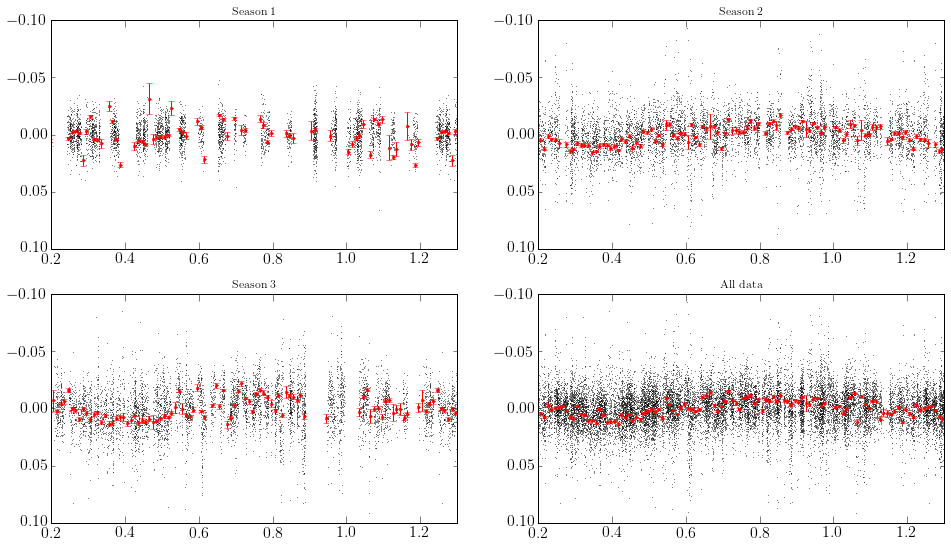

In [22]:

p = (HJD - epoch)/period
for i in range(0,len(p)):
    p[i] -= int(p[i])

phase_mags = [mag_phase_s1, mag_phase_s2, mag_phase_s3, mag_phase]
phase_errs = [err_phase_s1, err_phase_s2, err_phase_s3, err_phase]
phases = [phase_s1, phase_s2, phase_s3, phase]
seasons = [s1,s2,s3,sall]
ax_pos = [(0,0),(0,1),(1,0),(1,1)]
labels = ['Season 1','Season 2','Season 3','All data']

fig, axarr = plt.subplots(2,2)

fig.set_size_inches(16, 9)

for i in range(0,len(seasons)):
    axarr[ax_pos[i]].plot(p[seasons[i]],mag[seasons[i]],'k,',alpha=0.5)
    axarr[ax_pos[i]].plot(p[seasons[i]]+1,mag[seasons[i]],'k,',alpha=0.5)
    axarr[ax_pos[i]].errorbar(phases[i][[phase_mags[i] != 0.0][0]],phase_mags[i][[phase_mags[i] != 0.0][0]],yerr=phase_errs[i][[phase_mags[i] != 0.0][0]],fmt='r.')
    axarr[ax_pos[i]].errorbar(phases[i][[phase_mags[i] != 0.0][0]]+1,phase_mags[i][[phase_mags[i] != 0.0][0]],yerr=phase_errs[i][[phase_mags[i] != 0.0][0]],fmt='r.')
    axarr[ax_pos[i]].set_xlim(0.2,1.3)
    axarr[ax_pos[i]].set_ylim(0.1,-0.1)
    axarr[ax_pos[i]].set_title(labels[i])

plt.savefig('figures/phase_folded.pdf')

plt.show()

In [23]:
sigma = np.sqrt((np.std(mag_s2))**2 - (np.mean(err_s2))**2)

In [24]:
variance_window = pw.scale_averaged_power(wa,globspec, dj,gws_fitparams,peak_period/1.50,peak_period*1.50,sigma)
t, s = wa.time, wa.scales

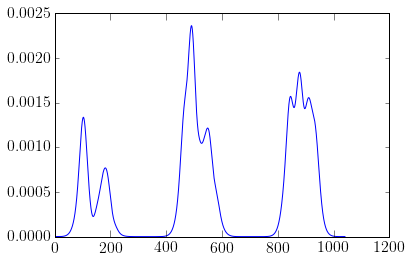

In [25]:
stdev_window = np.sqrt(variance_window)

plt.plot(t,stdev_window)
plt.show()

I'm interested in how the amplitude is changing over time. If I assume the wave is a sine wave (questionable) then from 
https://en.wikipedia.org/wiki/Root_mean_square#RMS_of_common_waveforms

$Amplitude = \sigma \sqrt{(2)}$

and if we also assume that this is purely due to spots, then

$Dimming = 2 \sigma \sqrt{(2)}$

Then, I can assume either coverage % or temperature to explore what's feasable

In [26]:
sine_amplitude = stdev_window * 2 * np.sqrt(2)

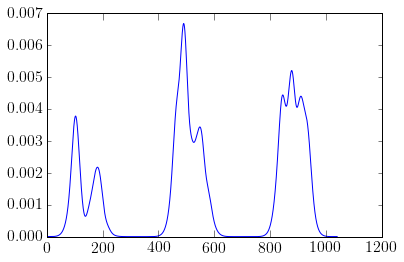

In [27]:
plt.plot(t,sine_amplitude)
plt.show()

So, according to this, I think that the variability of the star during the second season is of order 5 mmag, which means the spot/nonspot difference is ~ 1% let's make a quick first order approximation

$flux ratio = \left(\frac{T_{spot}}{T_{star}}\right)^4$

$1 - flux dimming = 1 - spot coverage + flux ratio * spot coverage$

$1 - flux dimming = 1 - spot coverage*( 1 - flux ratio)$

$spot coverage = (flux dimming) / (1 - flux ratio)$

In [28]:
spot_contrast = 500
T_sun = 5000.0
T_spot = 5000.0 - spot_contrast

flux_ratio = (T_spot/T_sun)**4
flux_dimming = 0.01
spot_coverage = (flux_dimming) / (1 - flux_ratio)

print spot_coverage

0.0290782204129


So at the very worst, the spot coverage was ~ 3%. This seems reasonable.

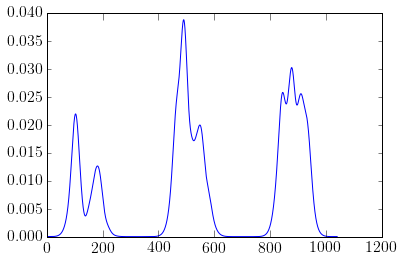

In [29]:
spot_contrast = 500
T_sun = 5000.0
T_spot = 5000.0 - spot_contrast

flux_ratio = (T_spot/T_sun)**4
flux_dimming = sine_amplitude*2
spot_coverage = (flux_dimming) / (1 - flux_ratio)

plt.plot(t,spot_coverage)
plt.show()